<a href="https://colab.research.google.com/github/GKS07/Computer_Vision/blob/main/Dogs_Classification_and_Detection_with_Imagenet_and_YOLO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Classifying and Detecting Dog breeds

I will use the pretrained model to classify the dog breeds and then to detect dog breed from image i will use Yolov8(it can be used for classification too.).


**Downloading the data from kaggle**

In [ ]:
# uploading the kaggle jason file

from google.colab import files
files.upload()

# copying the kaggle file

!mkdir ~/.kaggle # nmaking the folder

! cp kaggle.json ~/.kaggle/  #copy the file

#changing the permission.
! chmod 600 ~/.kaggle/kaggle.json


# downloading the data from kaggle

!kaggle datasets download -d jessicali9530/stanford-dogs-dataset
# making the folder
!mkdir Dog_Breeds

Saving kaggle.json to kaggle.json
 98% 736M/750M [00:05<00:00, 127MB/s]
100% 750M/750M [00:05<00:00, 140MB/s]


In [ ]:
#unzipping the data

!unzip stanford-dogs-dataset.zip -d Dog_Breeds

Streaming output truncated to the last 5000 lines.
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_11687.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_117.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_11807.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_11875.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_122.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_12232.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_125.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_12738.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_12739.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_12827.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_13340.jpg  
  inflating: Dog_Breeds/images/Images/n02108089-boxer/n02108089_13526.jpg  
  inflating: Dog_Breeds/images/Images/n0210

In [ ]:
# importing the libraries

import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import matplotlib.image as mpimg
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout,Flatten, Dense, Rescaling
from tensorflow.keras.activations import relu, softmax
from tensorflow.keras.callbacks import Callback, EarlyStopping,ModelCheckpoint
import seaborn as sns
import keras
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")


# Loading and Preprocessing the Images

In [ ]:
images_path = '/content/Dog_Breeds/images/Images'

In [ ]:
# function for the number of images of each breeds of dog

def dog_breeds(folder_path):
  for sub_dir in sorted(os.listdir(folder_path)):
      img_file = os.listdir(os.path.join(folder_path, sub_dir))
      out = print("The number of images of ",sub_dir, "is", len(img_file))
  return out


In [ ]:
dog_breeds(images_path)

The number of images of  n02085620-Chihuahua is 152
The number of images of  n02085782-Japanese_spaniel is 185
The number of images of  n02085936-Maltese_dog is 252
The number of images of  n02086079-Pekinese is 149
The number of images of  n02086240-Shih-Tzu is 214
The number of images of  n02086646-Blenheim_spaniel is 188
The number of images of  n02086910-papillon is 196
The number of images of  n02087046-toy_terrier is 172
The number of images of  n02087394-Rhodesian_ridgeback is 172
The number of images of  n02088094-Afghan_hound is 239
The number of images of  n02088238-basset is 175
The number of images of  n02088364-beagle is 195
The number of images of  n02088466-bloodhound is 187
The number of images of  n02088632-bluetick is 171
The number of images of  n02089078-black-and-tan_coonhound is 159
The number of images of  n02089867-Walker_hound is 153
The number of images of  n02089973-English_foxhound is 157
The number of images of  n02090379-redbone is 148
The number of images

In [ ]:
batch_size = 15
img_size = 256

#data augmentaion

augmented_images = Sequential([
                                layers.experimental.preprocessing.RandomFlip("vertical"),
                                layers.experimental.preprocessing.RandomRotation(0.2),
                                layers.experimental.preprocessing.RandomZoom(0.2),
                                layers.experimental.preprocessing.RandomContrast(0.3),
                                ], name = 'Augmenting_images')

#generating data
img_generator = ImageDataGenerator(
                                  preprocessing_function = tf.keras.applications.efficientnet.preprocess_input,
                                  validation_split = 0.2
                                  )

test_generator = ImageDataGenerator(
                                    preprocessing_function = tf.keras.applications.efficientnet.preprocess_input,
                                    #validation_split = 0.2
                                    )

#generating a training data
training_data = img_generator.flow_from_directory(images_path,
                                                    target_size = (img_size, img_size),
                                                    color_mode = 'rgb',
                                                    batch_size = batch_size,
                                                    class_mode = 'categorical',
                                                    shuffle = True,
                                                    seed = 43,
                                                    subset = 'training'
                                                    )


#generating the validation data

validation_data = img_generator.flow_from_directory(images_path,
                                                      target_size = (img_size, img_size),
                                                      color_mode = 'rgb',
                                                      batch_size = batch_size,
                                                      class_mode = 'categorical',
                                                      subset = 'validation',
                                                      shuffle = False
                                                      )


"""test_data = test_generator.flow_from_directory(dog,
                                               target_size = (img_size, img_size),
                                               color_mode = 'rgb',
                                               batch_size = batch_size,
                                               class_mode = 'categorical',
                                               #subset = 'validation'
                                               )"""

Found 16508 images belonging to 120 classes.
Found 4072 images belonging to 120 classes.


"test_data = test_generator.flow_from_directory(dog,\n                                               target_size = (img_size, img_size),\n                                               color_mode = 'rgb',\n                                               batch_size = batch_size,\n                                               class_mode = 'categorical',\n                                               #subset = 'validation'\n                                               )"

In [ ]:
print("The shape of the images is:",training_data.image_shape)

The shape of the images is: (256, 256, 3)


In [ ]:
# name of the dog breeds

breeds = [x for x in training_data.class_indices]

In [ ]:
breeds[1]

'n02085782-Japanese_spaniel'

In [ ]:
dogs_name = []

for breed in breeds:
  name = breed[10:]
  dogs_name.append(name)

In [ ]:
# function to display the images.

def display_one_dog(image, title, subplot, color):
  plt.subplot(subplot)
  plt.axis('off')
  plt.imshow(image*1./255)
  plt.title(title, fontsize=16, color=color)

# plotting the 9 images
def display_nine_dogs(images, titles, title_colors=None):
  subplot = 331
  plt.figure(figsize=(20,15))
  for i in range(9):
    color = 'black' if title_colors is None else title_colors[i]
    display_one_dog(images[i], titles[i], 331+i, color)
  plt.tight_layout()
  plt.subplots_adjust(wspace=0.1, hspace=0.1)
  plt.show()

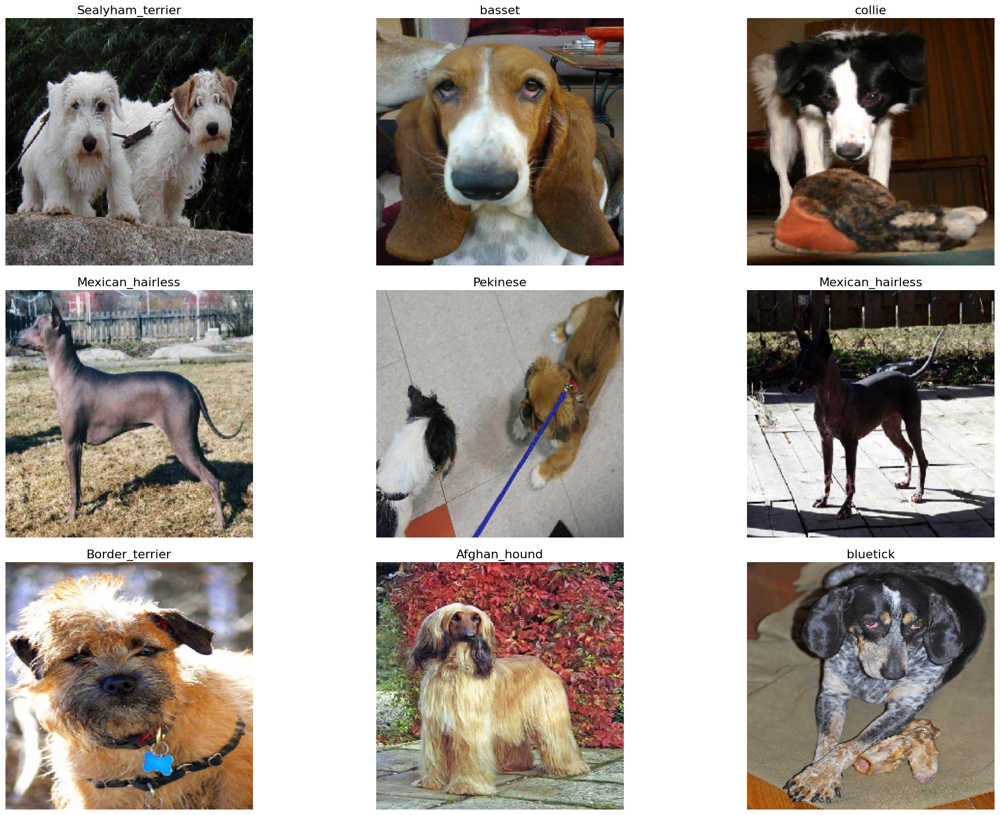

In [ ]:
# displaying the training data.
images, classes = next(training_data)
class_idxs = np.argmax(classes, axis=-1) # transform from one-hot array to class number
labels = [dogs_name[idx] for idx in class_idxs]
display_nine_dogs(images, labels)

# Creating a Classification model using EfficientNetB3 pretrained model.

In [ ]:
#importing the model.
from tensorflow.keras.applications import EfficientNetB3

#initialising the EfficientNetB3 model

base_model = EfficientNetB3(input_shape = training_data.image_shape,
                            include_top = False,
                            weights = 'imagenet',
                            pooling = 'max')

43941136/43941136 [==============================] - 0s 0us/step


In [ ]:
# freezing the layers of the model

for layer in base_model.layers:
  layer.trainable = False

In [ ]:
#composing the model on top of teh pretrained model.

def create_model():
  inputs = layers.Input(shape = training_data.image_shape, name = 'input_layer')

  x = augmented_images(inputs)

  base_model_out = base_model(x, training = False)

  x = Dense(525, activation  = 'relu', name = "hidden_layer")(base_model_out)

  x = layers.BatchNormalization()(x)

  x = Dropout(0.4)(x)

  outputs = Dense(120, activation = 'softmax', dtype = tf.float32, name = 'final_layer')(x)

  model = keras.models.Model(inputs = inputs, outputs = outputs)

  model.compile(optimizer = keras.optimizers.Adam(learning_rate = 0.0002),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])
  return model



In [ ]:
my_model = create_model()
my_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 256, 256, 3)]     0         
                                                                 
 Augmenting_images (Sequent  (None, 256, 256, 3)       0         
 ial)                                                            
                                                                 
 efficientnetb3 (Functional  (None, 1536)              10783535  
 )                                                               
                                                                 
 hidden_layer (Dense)        (None, 525)               806925    
                                                                 
 batch_normalization (Batch  (None, 525)               2100      
 Normalization)                                                  
                                                             

In [ ]:
epochs = 25

callback = tf.keras.callbacks.EarlyStopping(monitor = 'val_loss',
                                            patience = 3,
                                            restore_best_weights = True)

with tf.device('/device:GPU:0'):
  history = my_model.fit(training_data,
                         validation_data = validation_data,
                         callbacks = [callback],
                         verbose = 1,
                         epochs = epochs)

Epoch 1/25
1101/1101 [==============================] - 137s 107ms/step - loss: 2.6386 - accuracy: 0.3902 - val_loss: 0.5579 - val_accuracy: 0.8411
Epoch 2/25
1101/1101 [==============================] - 110s 100ms/step - loss: 1.6000 - accuracy: 0.5755 - val_loss: 0.4437 - val_accuracy: 0.8662
Epoch 3/25
1101/1101 [==============================] - 107s 97ms/step - loss: 1.4129 - accuracy: 0.6185 - val_loss: 0.4276 - val_accuracy: 0.8671
Epoch 4/25
1101/1101 [==============================] - 107s 97ms/step - loss: 1.3329 - accuracy: 0.6336 - val_loss: 0.4102 - val_accuracy: 0.8760
Epoch 5/25
1101/1101 [==============================] - 107s 97ms/step - loss: 1.2668 - accuracy: 0.6507 - val_loss: 0.4054 - val_accuracy: 0.8792
Epoch 6/25
1101/1101 [==============================] - 109s 99ms/step - loss: 1.2225 - accuracy: 0.6635 - val_loss: 0.4065 - val_accuracy: 0.8797
Epoch 7/25
1101/1101 [==============================] - 107s 97ms/step - loss: 1.1634 - accuracy: 0.6742 - val_loss:

**Evaluating the model**

In [ ]:
#displaying the learning curves:

def display_training_curves(training, validation, title, subplot):
  ax = plt.subplot(subplot)
  ax.plot(training)
  ax.plot(validation)
  ax.set_title('model '+ title)
  ax.set_ylabel(title)
  ax.set_xlabel('epoch')
  ax.legend(['training', 'validation'])

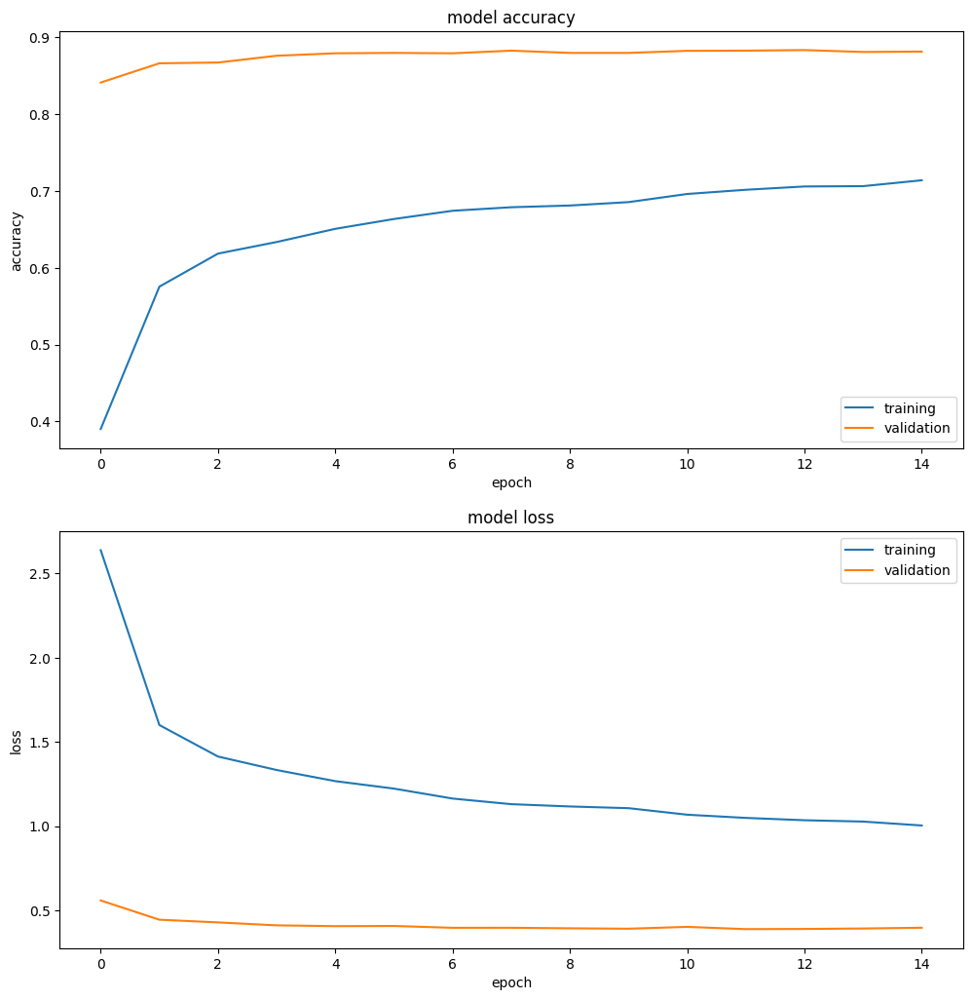

In [ ]:
plt.subplots(figsize=(10,10))
plt.tight_layout()

display_training_curves(history.history['accuracy'], history.history['val_accuracy'], 'accuracy', 211)
display_training_curves(history.history['loss'], history.history['val_loss'], 'loss', 212)


In [ ]:
#function for the evaluation of the model.

def evaluate_and_plot_confusion_matrix(model, generator):
    # Generate predictions
    y_pred = model.predict(generator)

    # Convert predictions to class labels
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Convert true labels to class labels
    y_true_classes = generator.classes

    # Get class labels
    class_labels = list(generator.class_indices.keys())

    # Calculate confusion matrix
    cm = confusion_matrix(y_true_classes, y_pred_classes)

    # Plot confusion matrix
    plt.figure(figsize=(25, 25))
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    # Display classification report
    print('\nClassification Report:\n', classification_report(y_true_classes, y_pred_classes, target_names=class_labels))

272/272 [==============================] - 21s 69ms/step


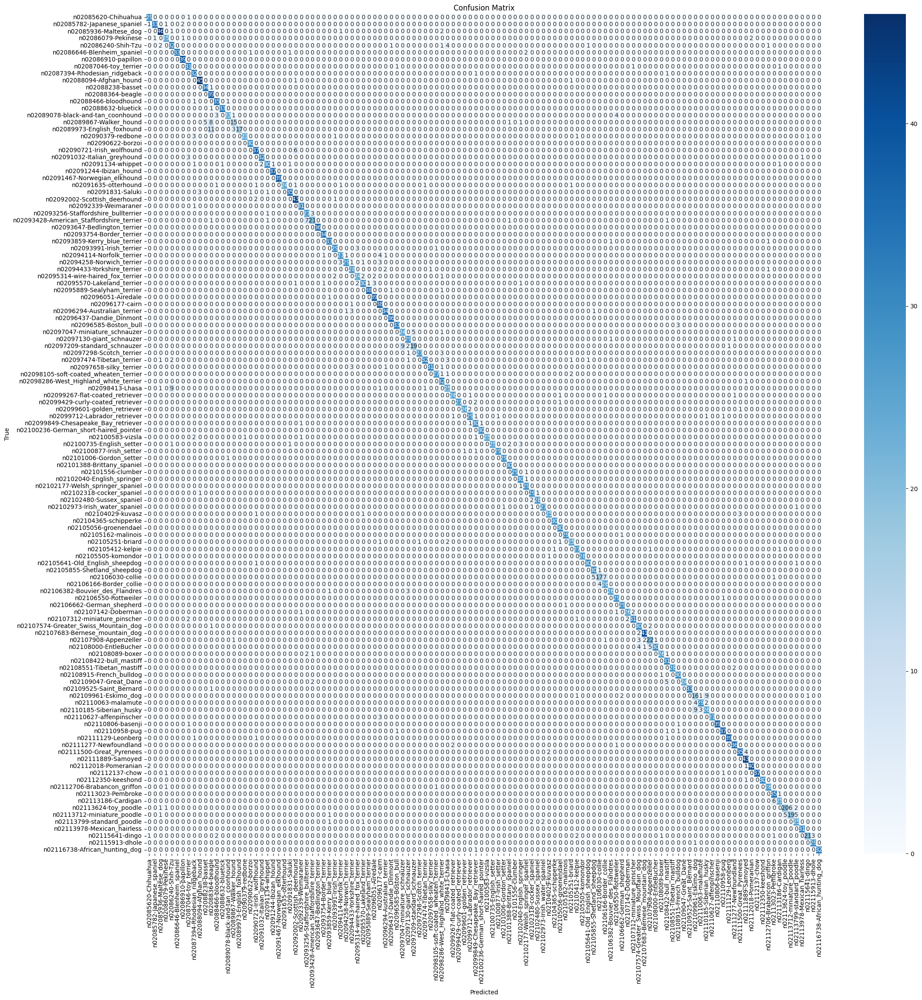


Classification Report:
                                           precision    recall  f1-score   support

                     n02085620-Chihuahua       0.88      0.97      0.92        30
              n02085782-Japanese_spaniel       0.97      0.89      0.93        37
                   n02085936-Maltese_dog       0.87      0.92      0.89        50
                      n02086079-Pekinese       0.86      0.86      0.86        29
                      n02086240-Shih-Tzu       0.71      0.76      0.74        42
              n02086646-Blenheim_spaniel       1.00      0.89      0.94        37
                      n02086910-papillon       0.93      1.00      0.96        39
                   n02087046-toy_terrier       0.82      0.91      0.86        34
           n02087394-Rhodesian_ridgeback       0.78      0.94      0.85        34
                  n02088094-Afghan_hound       0.92      0.96      0.94        47
                        n02088238-basset       0.87      0.97      0.92 

In [ ]:
#plotting confusion matrix and calssifiaction report of  model(evaluating model)
evaluate_and_plot_confusion_matrix(my_model, validation_data)

In [ ]:
#defining the function to get the predicted label

def dogs_title(label, prediction):
  # Both prediction (probabilities) and label (one-hot) are arrays with one item per class.
  class_idx = np.argmax(label, axis=-1)
  prediction_idx = np.argmax(prediction, axis=-1)
  if class_idx == prediction_idx:
    return f'{dogs_name[prediction_idx]} [correct]', 'green'
  else:
    return f'{dogs_name[prediction_idx]} [incorrect, should be {dogs_name[class_idx]}]', 'red'

def get_titles(images, labels, model):
  predictions = model.predict(images)
  titles, colors = [], []
  for label, prediction in zip(classes, predictions):
    title, color = dogs_title(label, prediction)
    titles.append(title)
    colors.append(color)
  return titles, colors

1/1 [==============================] - 0s 41ms/step


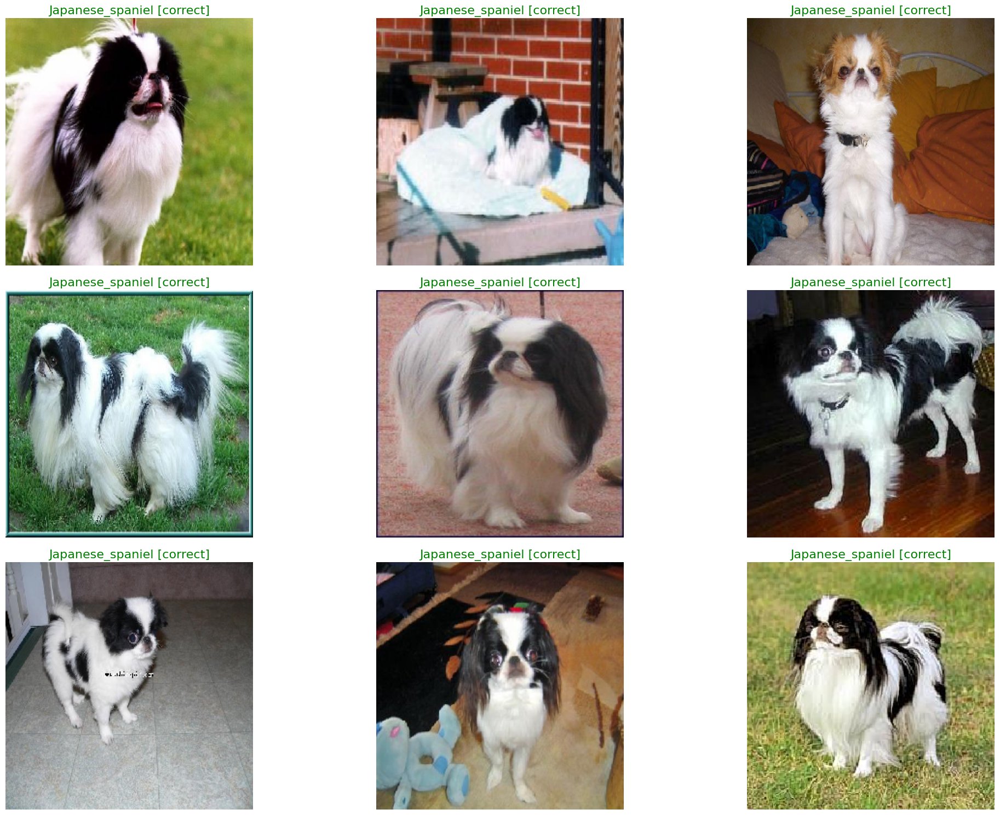

In [ ]:
# displaying the predicted data of vgg19_model.
images, classes = next(validation_data)
titles, colors = get_titles(images, classes, my_model)
display_nine_dogs(images, titles, colors)

# Detecting Dog Breeds using YOLOv8

Object detection is a computer vision task that involves identifying and locating objects in images or videos. It is an important part of many applications, such as self-driving cars, robotics, and video surveillance.

The best quality in performing these tasks comes from using convolutional neural networks.

One of the most popular neural networks for this task is YOLO, created in 2015 by Joseph Redmon, Santosh Divvala, Ross Girshick, and Ali Farhadi in their famous research paper "You Only Look Once: Unified, Real-Time Object Detection".

YOLOv8 is a group of convolutional neural network models, created and trained using the PyTorch framework.

There are three types of models and 5 models of different sizes for each type:

<table>
  <tr>
    <th>Classification</th>
    <th>Detection</th>
    <th>Segmentation</th>
    <th>Kind(Size)</th>
  </tr>
  <tr>
    <td>yolov8n-cls.pt</td>
    <td>yolov8n.pt</td>
    <td>yolov8n-seg.pt</td>
    <td>Nano</td>
  </tr>
  <tr>
    <td>yolov8s-cls.pt</td>
    <td>yolov8s.pt</td>
    <td>yolov8s-seg.pt</td>
    <td>Small</td>
  </tr>
  <tr>
    <td>yolov8sm-cls.pt</td>
    <td>yolov8m.pt</td>
    <td>yolov8m-seg.pt</td>
    <td>Medium</td>
  </tr>
  <tr>
    <td>yolov8l-cls.pt</td>
    <td>yolov8l.pt</td>
    <td>yolov8l-seg.pt</td>
    <td>Large</td>
  </tr>
  <tr>
    <td>yolov8x-cls.pt</td>
    <td>yolov8x.pt</td>
    <td>yolov8x-seg.pt</td>
    <td>Huge</td>
  </tr>
</table>

here .pt refers to pytorch

In [ ]:
#The ultralytics package has the YOLO class, used to create neural network models.
# lets install it.

!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 699.2/699.2 kB 10.2 MB/s eta 0:00:00


In [ ]:
# importing the yolo

from ultralytics import YOLO

In [ ]:
#Initialising the model

yolo_model = YOLO("yolov8m.pt")

In [ ]:
# predicting an image with pretrained yolo model

result = yolo_model.predict('/content/IMG_20190107_140047.jpg')


WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1 /content/IMG_20190107_140047.jpg: 640x480 7 persons, 1 tie, 11 bottles, 1 sandwich, 2 pizzas, 2 dining tables, 110.5ms
Speed: 15.2ms preprocess, 110.5ms inference, 738.2ms postprocess per image at shape (1, 3, 640, 480)


In [ ]:
#the number of boxes image have
res = result[0]
print(len(res.boxes))

24


In [ ]:
#details of detected objects
for box in res.boxes:
  label = res.names[box.cls[0].item()]
  cords = [round(x) for x in box.xyxy[0].tolist()]
  prob = box.conf[0].item()
  print("--------------"*5)
  print("Object name is", label)
  print("coordinates of teh object :", cords)
  print("Probability of the object is :", prob)
  print("---------------"*5)

----------------------------------------------------------------------
Object name is bottle
coordinates of teh object : [362, 1714, 732, 2944]
Probability of the object is : 0.9389322996139526
---------------------------------------------------------------------------
----------------------------------------------------------------------
Object name is person
coordinates of teh object : [1919, 2, 2910, 1708]
Probability of the object is : 0.9276772737503052
---------------------------------------------------------------------------
----------------------------------------------------------------------
Object name is bottle
coordinates of teh object : [2046, 1712, 2390, 2461]
Probability of the object is : 0.9024672508239746
---------------------------------------------------------------------------
----------------------------------------------------------------------
Object name is tie
coordinates of teh object : [2188, 3, 2409, 762]
Probability of the object is : 0.8806236982345581


In [ ]:
from PIL import Image

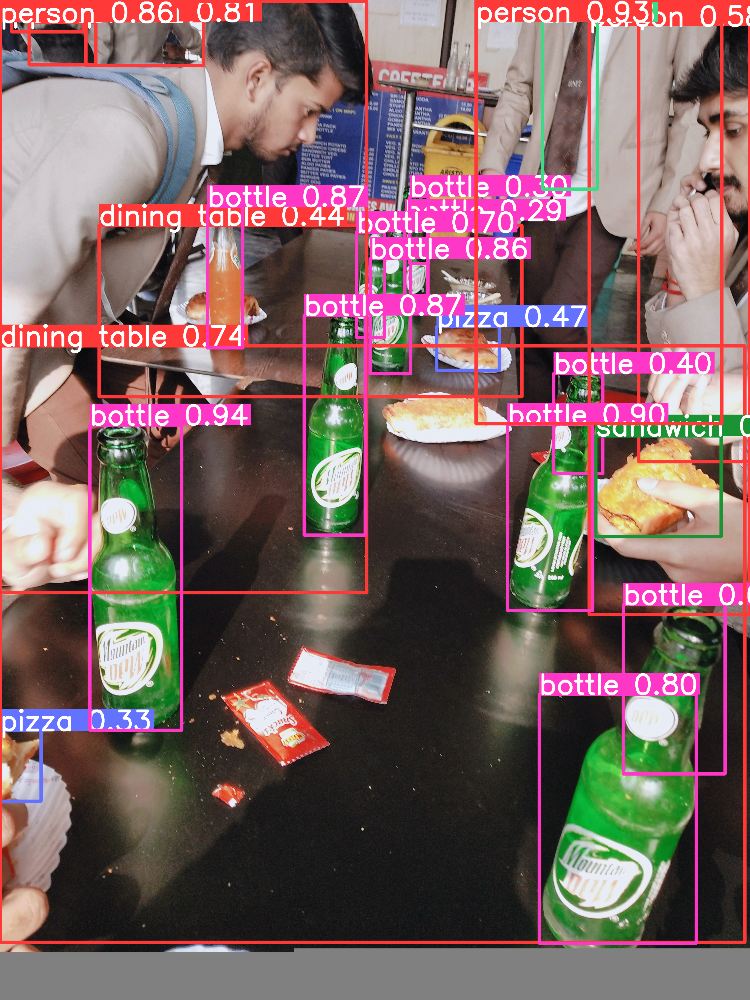

In [ ]:
Image.fromarray(res.plot()[:, :, ::-1])

#Prepearing data for YOLO model

**Making a DataFrame**

In [ ]:
annotation_ = '/content/Dog_Breeds/annotations/Annotation'

In [ ]:
breed_dir = [breed for breed in sorted(os.listdir(images_path))]

len(breed_dir), breed_dir[:5]

(120,
 ['n02085620-Chihuahua',
  'n02085782-Japanese_spaniel',
  'n02085936-Maltese_dog',
  'n02086079-Pekinese',
  'n02086240-Shih-Tzu'])

In [ ]:
dataset_df = pd.DataFrame(columns=["breed", "image_path", "annotation_path"])

for i, breed_dir in enumerate(breed_dir):
    breed_name = " ".join(breed_dir.replace("_", "-").split("-")[1:]).title()

    breed_images_dir_path = os.path.join(images_path, breed_dir)
    breed_annotations_dir_path = os.path.join(annotation_, breed_dir)

    breed_images_name = [
            image
            for image in sorted(os.listdir(breed_images_dir_path))
            if not image.startswith(".") and image.endswith((".jpg", ".jpeg", ".png"))
    ]
    breed_annotations_name = [
            image.split(".")[0]
            for image in breed_images_name
    ]

    breed_images_path = [
            os.path.join(breed_images_dir_path, image)
            for image in breed_images_name
            #if os.path.isfile(breed_images_dir_path / image)
    ]
    breed_annotations_path = [
            os.path.join(breed_annotations_dir_path, annotation)
            for annotation in breed_annotations_name
            #if os.path.isfile(breed_annotations_dir_path / annotation)
    ]

    dataset_df = pd.concat([dataset_df, pd.DataFrame({"breed": breed_name, "image_path": breed_images_path, "annotation_path": breed_annotations_path})])


dataset_df

,breed,image_path,annotation_path
0,Chihuahua,/content/Dog_Breeds/images/Images/n02085620-Ch...,/content/Dog_Breeds/annotations/Annotation/n02...
1,Chihuahua,/content/Dog_Breeds/images/Images/n02085620-Ch...,/content/Dog_Breeds/annotations/Annotation/n02...
2,Chihuahua,/content/Dog_Breeds/images/Images/n02085620-Ch...,/content/Dog_Breeds/annotations/Annotation/n02...
3,Chihuahua,/content/Dog_Breeds/images/Images/n02085620-Ch...,/content/Dog_Breeds/annotations/Annotation/n02...
4,Chihuahua,/content/Dog_Breeds/images/Images/n02085620-Ch...,/content/Dog_Breeds/annotations/Annotation/n02...
...,...,...,...
164,African Hunting Dog,/content/Dog_Breeds/images/Images/n02116738-Af...,/content/Dog_Breeds/annotations/Annotation/n02...
165,African Hunting Dog,/content/Dog_Breeds/images/Images/n02116738-Af...,/content/Dog_Breeds/annotations/Annotation/n02...
166,African Hunting Dog,/content/Dog_Breeds/images/Images/n02116738-Af...,/content/Dog_Breeds/annotations/Annotation/n02...
167,African Hunting Dog,/content/Dog_Breeds/images/Images/n02116738-Af...,/content/Dog_Breeds/annotations/Annotation/n02...


In [ ]:
dataset_df.shape

(20580, 3)

In [ ]:
#making a new directory for modified data
!mkdir Dogs_Data

In [ ]:
data_path = "/content/Dogs_Data/dataset.csv"

dataset_df = dataset_df.sort_values(by=["breed", "image_path"])
dataset_df.to_csv(data_path, index=False)

dataset_df = pd.read_csv(data_path)
dataset_df.head()

,breed,image_path,annotation_path
0,Affenpinscher,/content/Dog_Breeds/images/Images/n02110627-af...,/content/Dog_Breeds/annotations/Annotation/n02...
1,Affenpinscher,/content/Dog_Breeds/images/Images/n02110627-af...,/content/Dog_Breeds/annotations/Annotation/n02...
2,Affenpinscher,/content/Dog_Breeds/images/Images/n02110627-af...,/content/Dog_Breeds/annotations/Annotation/n02...
3,Affenpinscher,/content/Dog_Breeds/images/Images/n02110627-af...,/content/Dog_Breeds/annotations/Annotation/n02...
4,Affenpinscher,/content/Dog_Breeds/images/Images/n02110627-af...,/content/Dog_Breeds/annotations/Annotation/n02...


Now we need to split the data into train and validation data, convert the annotation file to .txt format. and to label the breed_names

In [ ]:
#assigining the label to each breed
breeds = dataset_df["breed"].unique()
breeds_name = {i: breed for i, breed in enumerate(breeds)}

breed_id = {breed: i for i, breed in breeds_name.items()}

breed_id["Gordon Setter"], breeds_name[53]

(50, 'Greater Swiss Mountain Dog')

In [ ]:
!pip install xmltodict

In [ ]:
import pathlib
import yaml
import xmltodict
import cv2

In [ ]:
!mkdir ANNOTATIONS_PATH

In [ ]:
new_ann = '/content/ANNOTATIONS_PATH'

In [ ]:
#converting the annotation file to .txt file.

new_annotations = []

for i, annotation_path in enumerate(dataset_df["annotation_path"]):
    annotation_path = pathlib.Path(annotation_path)
    new_annotation_path = os.path.join(new_ann , annotation_path.parent.name)
    os.makedirs(new_annotation_path, exist_ok=True)
    annotation_name = annotation_path.name

    annotation_data = xmltodict.parse(annotation_path.read_text())
    image_w, image_h = (
        int(annotation_data["annotation"]["size"]["width"]),
        int(annotation_data["annotation"]["size"]["height"])
    )
    final_data = ""
    objects = annotation_data["annotation"]["object"]
    if not isinstance(objects, list):
        objects = [objects]

    for obj in objects:
        breed = obj["name"]
        xmin, ymin, xmax, ymax = (
            int(obj["bndbox"]["xmin"]),
            int(obj["bndbox"]["ymin"]),
            int(obj["bndbox"]["xmax"]),
            int(obj["bndbox"]["ymax"])
        )
        obj_h = ymax - ymin
        obj_w = xmax - xmin
        class_id = breed_id[breed.replace("_", " ").replace("-", " ").title()]
        x, y, w, h = (
            (xmin + obj_w/2) / image_w,
            (ymin + obj_h/2) / image_h,
            (obj_w) /image_w ,
            (obj_h) / image_h
        )

        final_data += f"{class_id} {x} {y} {w} {h}\n"

    new_annotation_path = os.path.join(new_annotation_path, (annotation_name+".txt"))
    f = open(new_annotation_path, "w")
    f.write(final_data)
    f.close()
    #new_annotation_path.write(final_data)
    new_annotations.append(new_annotation_path)

In [ ]:
# Adding the new annotation path to the dataframe

dataset_df["new_annotation_path"] = new_annotations
dataset_df.to_csv(data_path, index=False)

dataset_df = dataset_df.sample(frac=1).reset_index(drop=True)
dataset_df

,breed,image_path,annotation_path,new_annotation_path
0,Greater Swiss Mountain Dog,/content/Dog_Breeds/images/Images/n02107574-Gr...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02107574-Greater_Sw...
1,Collie,/content/Dog_Breeds/images/Images/n02106030-co...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02106030-collie/n02...
2,Border Terrier,/content/Dog_Breeds/images/Images/n02093754-Bo...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02093754-Border_ter...
3,English Springer,/content/Dog_Breeds/images/Images/n02102040-En...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02102040-English_sp...
4,Bernese Mountain Dog,/content/Dog_Breeds/images/Images/n02107683-Be...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02107683-Bernese_mo...
...,...,...,...,...
20575,Malamute,/content/Dog_Breeds/images/Images/n02110063-ma...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02110063-malamute/n...
20576,Siberian Husky,/content/Dog_Breeds/images/Images/n02110185-Si...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02110185-Siberian_h...
20577,Schipperke,/content/Dog_Breeds/images/Images/n02104365-sc...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02104365-schipperke...
20578,Miniature Poodle,/content/Dog_Breeds/images/Images/n02113712-mi...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02113712-miniature_...


In [ ]:
!mkdir New_Dogs_Data

In [ ]:
new_data_path = '/content/New_Dogs_Data'

In [ ]:
# creating train test and validation df

test_df = dataset_df.sample(frac = 0.1)
train_df = dataset_df.drop(test_df.index)

train_df = train_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

train_df_path = os.path.join(new_data_path, "train_df.csv")
test_df_path = os.path.join(new_data_path, "test_df.csv")

train_df.to_csv(train_df_path, index=False)
test_df.to_csv(test_df_path, index=False)


val_df = train_df.sample(frac = 0.15)
train_df = train_df.drop(val_df.index)

train_img,val_img,test_img = len(train_df), len(val_df), len(test_df)

print(f"Train set has {train_img} images")
print(f"Validation set has {val_img} images")
print(f"Test set has {test_img} images")

Train set has 15744 images
Validation set has 2778 images
Test set has 2058 images


In [ ]:
train_df.head()

,breed,image_path,annotation_path,new_annotation_path
0,Lhasa,/content/Dog_Breeds/images/Images/n02098413-Lh...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02098413-Lhasa/n020...
2,Italian Greyhound,/content/Dog_Breeds/images/Images/n02091032-It...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02091032-Italian_gr...
3,Border Collie,/content/Dog_Breeds/images/Images/n02106166-Bo...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02106166-Border_col...
4,Siberian Husky,/content/Dog_Breeds/images/Images/n02110185-Si...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02110185-Siberian_h...
5,Australian Terrier,/content/Dog_Breeds/images/Images/n02096294-Au...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02096294-Australian...


Now i will create a folder in which i'll store images and label(new annotation file.)

In [ ]:
#creating a training and validation folder

train_dir = os.path.join(new_data_path, "Train")
val_dir = os.path.join(new_data_path, "Validation")
test_dir = os.path.join(new_data_path, "Test")

# adding images and labels to the train folder.
try:

  for image_path, label_path in zip(train_df["image_path"], train_df["new_annotation_path"]):
          image_path = pathlib.Path(image_path)
          label_path = pathlib.Path(label_path)
          images_dir_path = os.path.join(train_dir, "images")
          labels_dir_path = os.path.join(train_dir, "labels")
          os.makedirs(images_dir_path, exist_ok=True)
          os.makedirs(labels_dir_path, exist_ok=True)

          os.symlink(image_path, os.path.join(images_dir_path, image_path.name))
          os.symlink(label_path, os.path.join(labels_dir_path, label_path.name))

  #adding imagews and labels to validation folder

  for image_path, label_path in zip(val_df["image_path"], val_df["new_annotation_path"]):
          image_path = pathlib.Path(image_path)
          label_path = pathlib.Path(label_path)
          images_dir_path = os.path.join(val_dir, "images")
          labels_dir_path = os.path.join(val_dir, "labels")
          os.makedirs(images_dir_path, exist_ok=True)
          os.makedirs(labels_dir_path, exist_ok=True)

          os.symlink(image_path, os.path.join(images_dir_path, image_path.name))
          os.symlink(label_path, os.path.join(labels_dir_path, label_path.name))

  #adding images and labels to the test folder.

  for image_path, label_path in zip(test_df["image_path"], test_df["new_annotation_path"]):
          image_path = pathlib.Path(image_path)
          label_path = pathlib.Path(label_path)
          images_dir_path = os.path.join(test_dir, "images")
          labels_dir_path = os.path.join(test_dir, "labels")
          os.makedirs(images_dir_path, exist_ok=True)
          os.makedirs(labels_dir_path, exist_ok=True)

          os.symlink(image_path, os.path.join(images_dir_path, image_path.name))
          os.symlink(label_path, os.path.join(labels_dir_path, label_path.name))

except FileExistsError:
  pass

lets make the .yaml file containing the information about the data.
(this yaml file will be feed to the YOLOv8 model.)

In [ ]:
#creating a yaml file.

dataset_details = {
    "path": str(new_data_path),
    "train": "Train",
    "val": "Validation",
    "test": "Test",

    "names": breeds_name
}

yaml_path = os.path.join('/content/YML_FILE', "dataset.yaml")
os.makedirs(os.path.dirname(yaml_path), exist_ok=True)

with open(yaml_path, "w") as f:
    yaml.dump(dataset_details, f, default_flow_style=False)

CLASS_NAMES = list(breeds_name.values())
NUM_CLASSES = len(CLASS_NAMES)

**Displaying the Images**

In [ ]:
dataset_df.head()

,breed,image_path,annotation_path,new_annotation_path
0,Lhasa,/content/Dog_Breeds/images/Images/n02098413-Lh...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02098413-Lhasa/n020...
1,Kuvasz,/content/Dog_Breeds/images/Images/n02104029-ku...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02104029-kuvasz/n02...
2,Italian Greyhound,/content/Dog_Breeds/images/Images/n02091032-It...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02091032-Italian_gr...
3,Border Collie,/content/Dog_Breeds/images/Images/n02106166-Bo...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02106166-Border_col...
4,Siberian Husky,/content/Dog_Breeds/images/Images/n02110185-Si...,/content/Dog_Breeds/annotations/Annotation/n02...,/content/ANNOTATIONS_PATH/n02110185-Siberian_h...


In [ ]:
dataset_df[["image_path","new_annotation_path"]][:5]

,image_path,new_annotation_path
0,/content/Dog_Breeds/images/Images/n02098413-Lh...,/content/ANNOTATIONS_PATH/n02098413-Lhasa/n020...
1,/content/Dog_Breeds/images/Images/n02104029-ku...,/content/ANNOTATIONS_PATH/n02104029-kuvasz/n02...
2,/content/Dog_Breeds/images/Images/n02091032-It...,/content/ANNOTATIONS_PATH/n02091032-Italian_gr...
3,/content/Dog_Breeds/images/Images/n02106166-Bo...,/content/ANNOTATIONS_PATH/n02106166-Border_col...
4,/content/Dog_Breeds/images/Images/n02110185-Si...,/content/ANNOTATIONS_PATH/n02110185-Siberian_h...


In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
images2, cls_idx, boxes = [],[],[]
data_sample = dataset_df.sample(8)


for img, anno in zip(data_sample["image_path"], data_sample["new_annotation_path"]):

  #print(anno)
  images2.append(img)
  with open(anno, "r") as f:
    data = f.readlines()

    for line in data:
      cls_, x, y, w, h = line.split()
      cls_, x, y, w, h = int(cls_), float(x), float(y), float(w), float(h)
      boxes.append([x, y, w, h])
      cls_idx.append(cls_)



In [ ]:
# function for displaying modified images

def display_dogs(image,
                 class_index: list[int],
                 rec_pram: list[float]):

  img_dis = []
  cmap = plt.get_cmap("tab20b")
  colors = np.array([cmap(i%20)[:-1] for i in range(NUM_CLASSES)]) * 255

  for i in range(len(image)):
    x1, y1, x2, y2 = rec_pram[i]

    img = cv2.imread(images2[i])

    image_h, image_w, _ = img.shape

    #getting the rectangle parameter

    x1 , y1, x2, y2 = (x1 * image_w,
                       y1 * image_h,
                       x2 * image_w,
                       y2 * image_h
                       )


    x3, x4 = int(x1 - x2 / 2), int(x1 + y2 / 2)
    y3, y4 = int(y1 - y2 / 2), int(y1 + y2 / 2)
    start_point  = (x3,y3)
    end_point = (x4, y4)

    #getting the class name(dog_breed_name)

    b_col = colors[int(class_index[i])]


    dog_breed_name = breeds_name[cls_idx[i]]
    text_size, _ = cv2.getTextSize(dog_breed_name, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
    text_position = (x3 + 1, y4 - 2)

    #defining the text background

    image_cv = cv2.rectangle(img,
                            (x3, y4),
                            (x3 + text_size[0], y4 - text_size[1] - 4),
                            b_col,
                            -1,  # this will fill the whole rectangle
                            )
    image_cv = cv2.putText(image_cv,
                          dog_breed_name,
                          text_position,
                          cv2.FONT_HERSHEY_SIMPLEX,
                          0.6,
                          (0, 0, 255 ),
                          2,
                          cv2.LINE_AA,
                          False
                          )

    img = cv2.rectangle(image_cv, start_point, end_point, b_col,4)

    img_dis.append(img)
  return img_dis


def display_img_of_dog(dog_img):
  subplot = 331
  plt.figure(figsize = (20,15))

  for j in range(len(dog_img)):
    disp_dog(dog_img[j], 331+j)

  plt.tight_layout()
  plt.subplots_adjust(wspace = 0.1, hspace = 0.1)
  plt.show()

def disp_dog(imgdog, subplot):
  plt.subplot(subplot)
  plt.axis('off')
  plt.imshow(imgdog)
  #cv2_imshow(img)
  #cv2.waitKey(0)
  #cv2.destroyAllWindows()


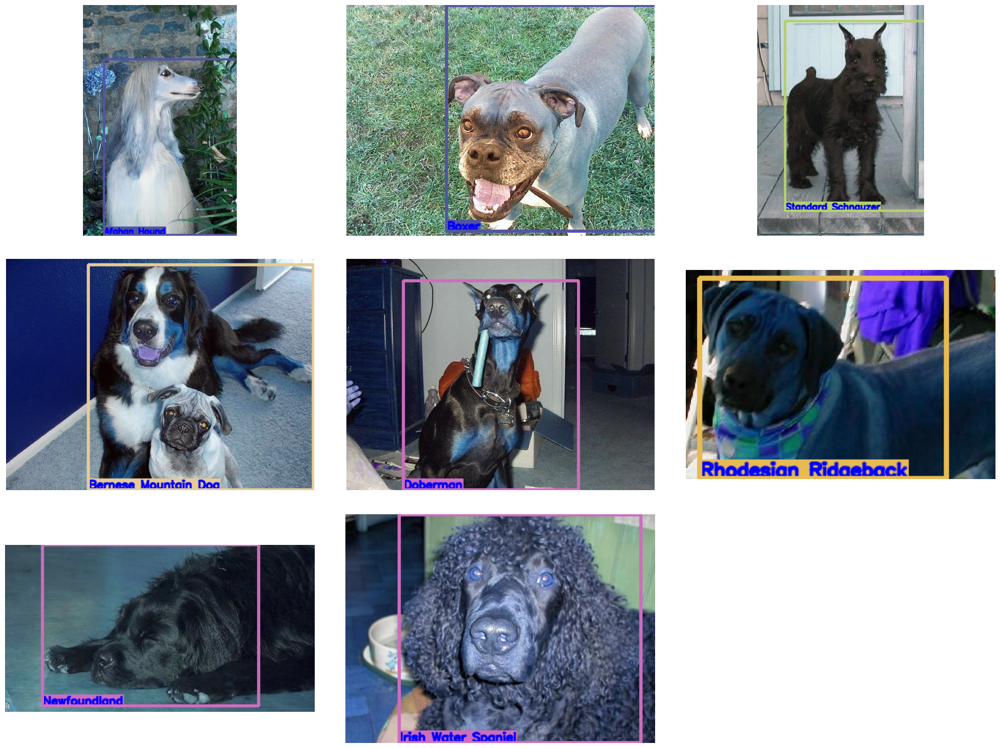

In [ ]:
dog_img_array = display_dogs(images2, cls_idx, boxes)
display_img_of_dog(dog_img_array)

# Training the YOLO model on new data.

In [ ]:
with tf.device('/device:GPU:0'):

  !yolo task = detect mode = train model = yolov8n.pt data = '/content/YML_FILE/dataset.yaml' epochs=20 imgsz=800 plots=True

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/YML_FILE/dataset.yaml, epochs=10, time=None, patience=50, batch=16, imgsz=256, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sh

In [ ]:
!ls runs/detect/train4

args.yaml					     PR_curve.png	    val_batch0_pred.jpg
confusion_matrix_normalized.png			     R_curve.png	    val_batch1_labels.jpg
confusion_matrix.png				     results.csv	    val_batch1_pred.jpg
events.out.tfevents.1704960100.94b93e35f5ca.19755.0  results.png	    val_batch2_labels.jpg
F1_curve.png					     train_batch0.jpg	    val_batch2_pred.jpg
labels_correlogram.jpg				     train_batch1.jpg	    weights
labels.jpg					     train_batch2.jpg
P_curve.png					     val_batch0_labels.jpg


In [ ]:
# function for displaying results.
def display_results(img, title):
  plt.figure(figsize = (20,25))
  plt.imshow(Image.open(img))
  plt.title(title)
  plt.show()


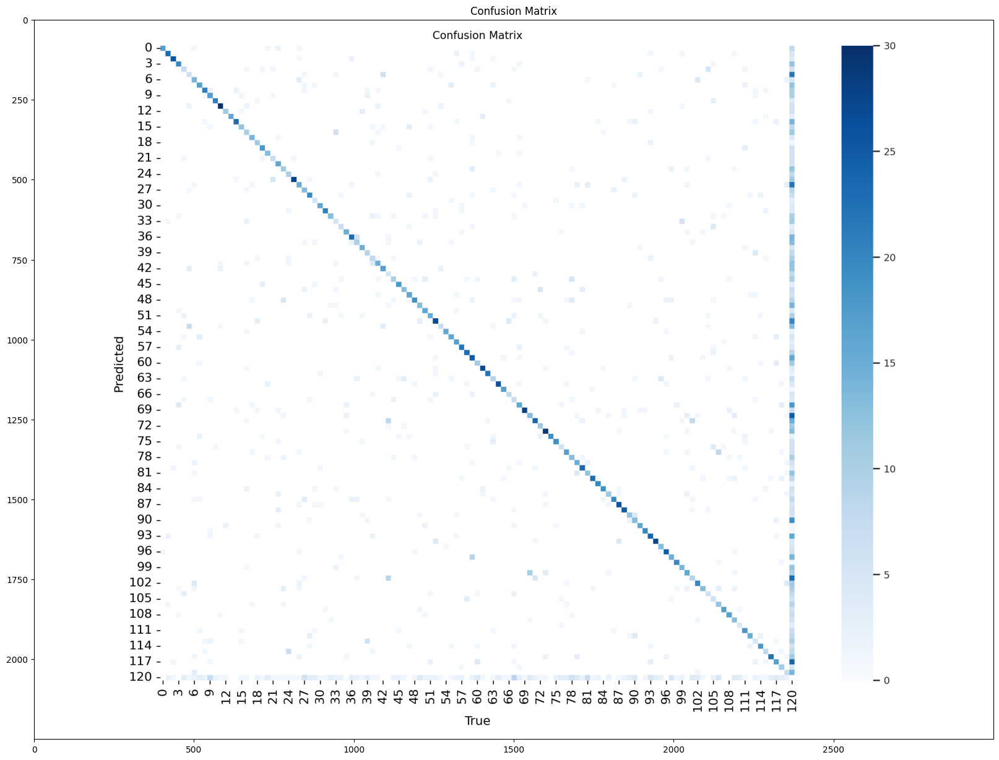

In [ ]:
#Plotting the Confusion matrix

display_results('/content/runs/detect/train4/confusion_matrix.png', 'Confusion Matrix')

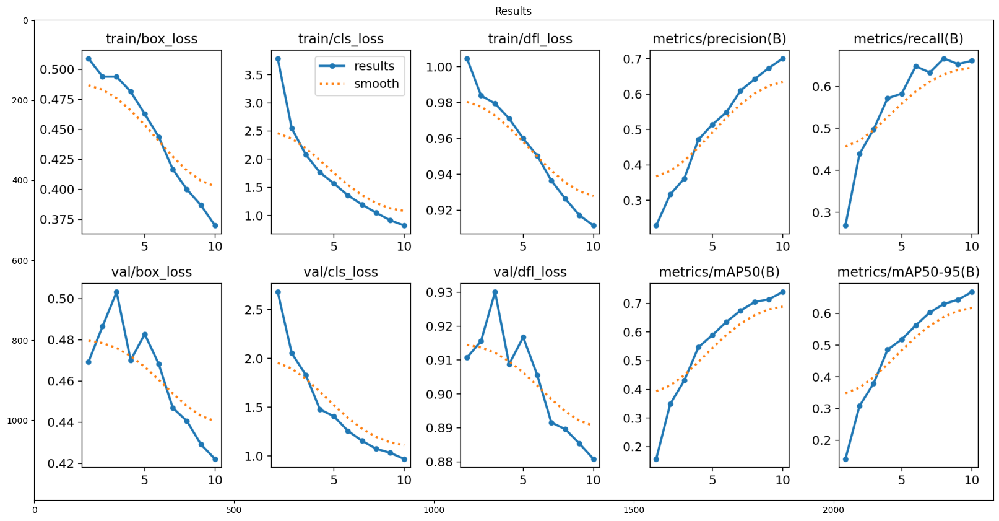

In [ ]:
# displaying results of trained model
display_results('/content/runs/detect/train4/results.png', 'Results')

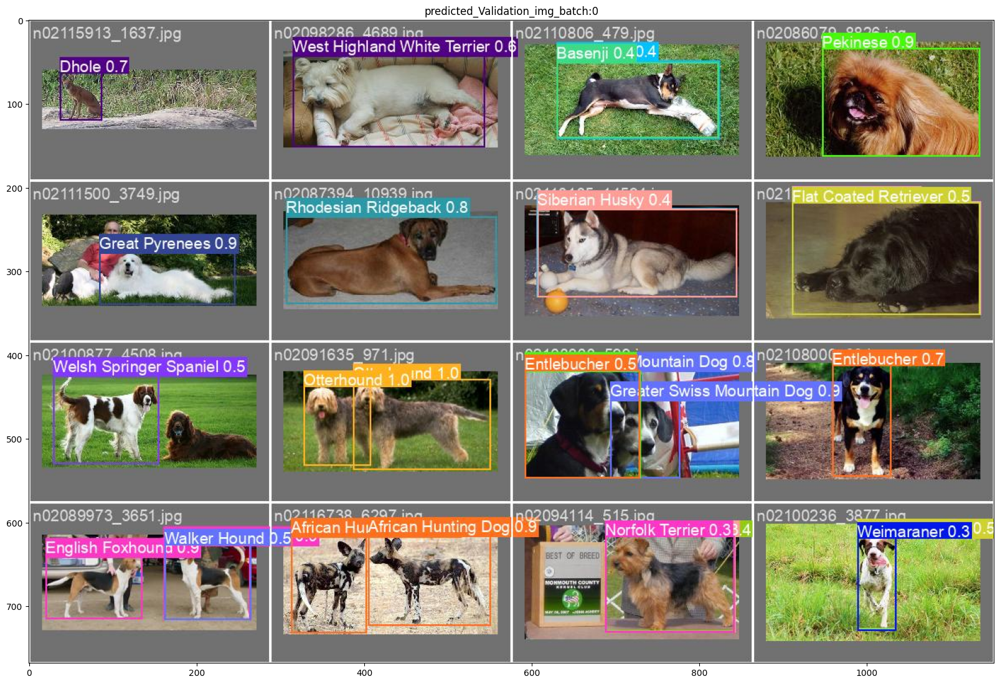

In [ ]:
#displaying the  predicted validation data of batch 0:

display_results('/content/runs/detect/train4/val_batch0_pred.jpg', 'predicted_Validation_img_batch:0')

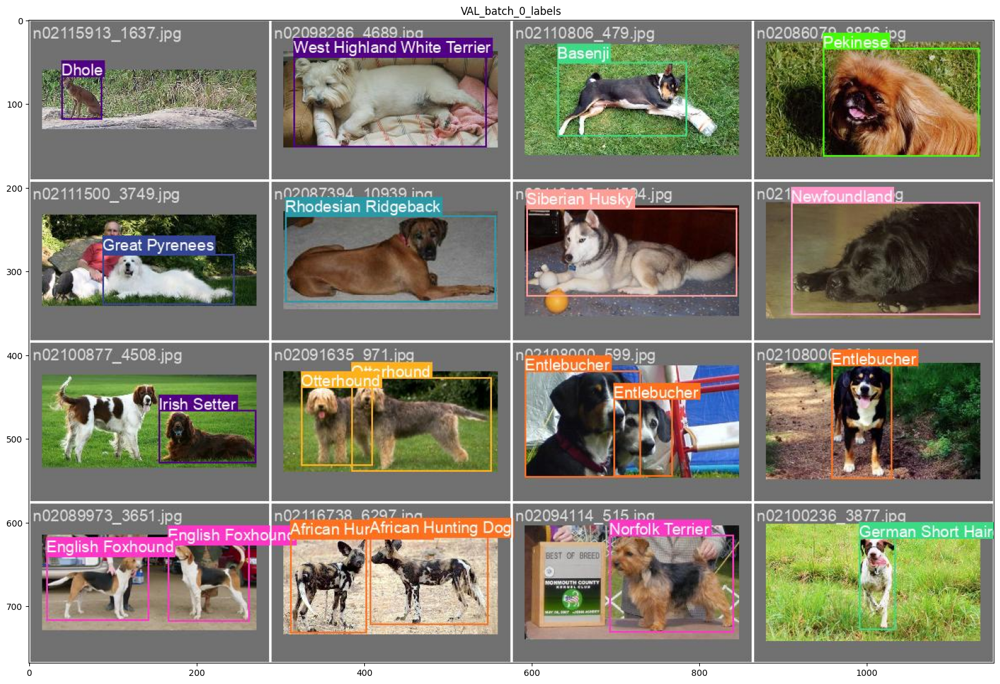

In [ ]:
display_results('/content/runs/detect/train4/val_batch0_labels.jpg', 'VAL_batch_0_labels')

# Validating the model

In [81]:
!yolo task=detect mode=val model=/content/runs/detect/train4/weights/best.pt data=/content/YML_FILE/dataset.yaml

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25909240 parameters, 0 gradients, 79.1 GFLOPs
val: Scanning /content/New_Dogs_Data/Validation/labels.cache... 2778 images, 0 backgrounds, 1 corrupt: 100% 2778/2778 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/New_Dogs_Data/Validation/images/n02106030_3948.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0278]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 174/174 [00:23<00:00,  7.51it/s]
                   all       2777       2986      0.701      0.659       0.74      0.668
         Affenpinscher       2777         18      0.691      0.869      0.904      0.778
          Afghan Hound       2777         29      0.815      0.862      0.883      0.834
   African Hunting Dog       2777         29      0.837      0.862      0.928      0.793
              Airedale       2777         32     

# Infrencing the model on test data

In [85]:
!yolo task=detect mode=predict model=/content/runs/detect/train4/weights/best.pt conf=0.40 source=/content/New_Dogs_Data/Test/images

Ultralytics YOLOv8.1.0 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25909240 parameters, 0 gradients, 79.1 GFLOPs

image 1/2058 /content/New_Dogs_Data/Test/images/n02085620_10074.jpg: 256x192 1 Chihuahua, 1 Pembroke, 123.0ms
image 2/2058 /content/New_Dogs_Data/Test/images/n02085620_1235.jpg: 192x256 (no detections), 72.6ms
image 3/2058 /content/New_Dogs_Data/Test/images/n02085620_1346.jpg: 192x256 1 Chihuahua, 1 Papillon, 11.9ms
image 4/2058 /content/New_Dogs_Data/Test/images/n02085620_1765.jpg: 256x224 1 Toy Terrier, 69.7ms
image 5/2058 /content/New_Dogs_Data/Test/images/n02085620_2507.jpg: 192x256 (no detections), 12.5ms
image 6/2058 /content/New_Dogs_Data/Test/images/n02085620_2517.jpg: 192x256 1 Toy Terrier, 11.8ms
image 7/2058 /content/New_Dogs_Data/Test/images/n02085620_2590.jpg: 192x256 (no detections), 11.8ms
image 8/2058 /content/New_Dogs_Data/Test/images/n02085620_2887.jpg: 256x256 1 Chihuahua, 13.6ms
image 9/2058 /content/

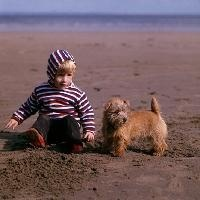

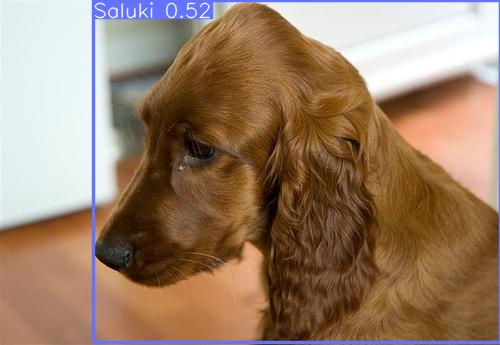

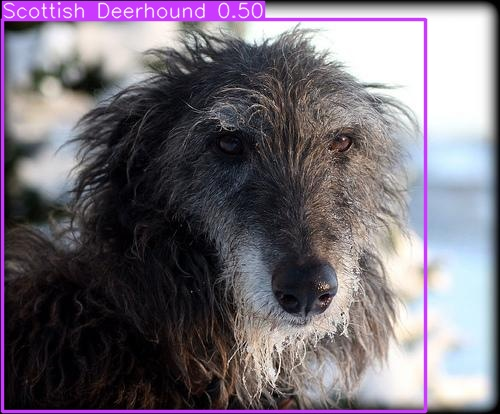

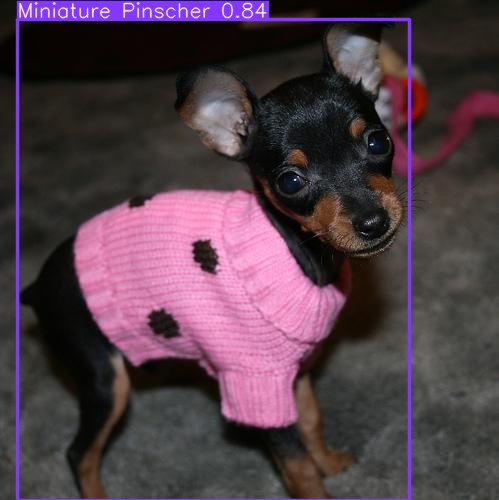

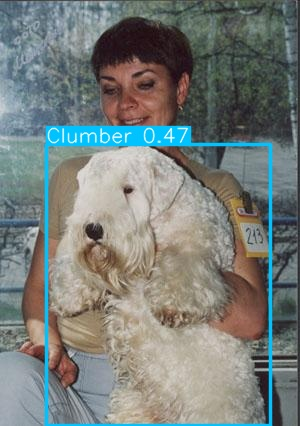

...

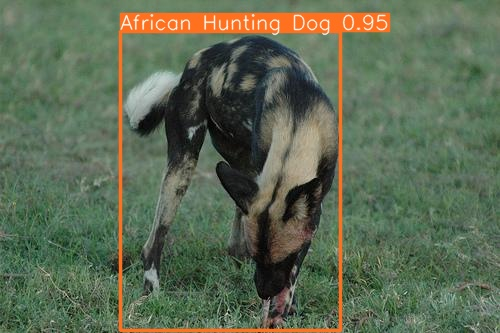

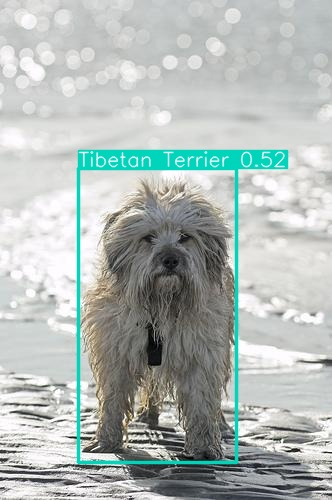

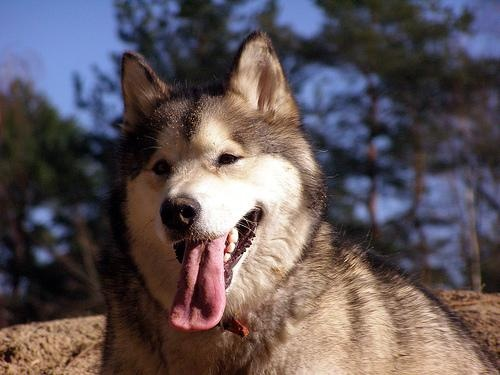

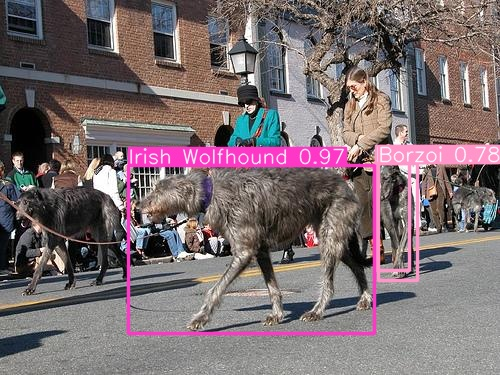

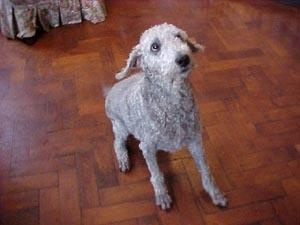

In [86]:
#displaying some predicted images

import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict3/*.jpg')[10:21]:
      display(Image(filename=image_path, width=600))
      print("\n")